In [1]:
from numpy.random import seed
seed(42)
from tensorflow import random
random.set_seed(42)
"""
DNN Experiments Serrano/AUDSOME Phase 1
Gabriel Iuhasz

Single Model experiment based on HPO optimization

Anomaly Only
"""

import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold, StratifiedShuffleSplit
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import balanced_accuracy_score, make_scorer, classification_report, accuracy_score, jaccard_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
from imblearn.metrics import classification_report_imbalanced
from subprocess import check_output
# from sklearn.externals import joblib
from joblib import dump, load
import os
import matplotlib.pyplot as plt
import seaborn as sns
import shap
%matplotlib inline


print("Checking files in data location ...")
train_dir = '/Users/Gabriel/Dropbox/Research/ASPIDE/Datasets/ECI Chaos/Distributed Phase 1/finalized/single_node/training'
# train_dir = '/home/gabriel/Research/Aspide/workspace/data_phase'
# train_dir = '/home/gabriel/research/dipet/serrano/data'
print(check_output(["ls", train_dir]).decode("utf8"))

Checking files in data location ...
data
df_anomaly.csv
df_audsome.csv
df_clean_ausdome_single.csv
df_clean_single.csv
models
processed



In [2]:
print("Setting paths and datasets")
# Checking if directory exists for data, modells and processed

data_dir = os.path.join(train_dir,'data')
model_dir = os.path.join(train_dir,'models')
processed_dir = os.path.join(train_dir,'processed')
if not os.path.exists(data_dir):
    os.makedirs(data_dir)
if not os.path.exists(model_dir):
    os.makedirs(model_dir)
if not os.path.exists(processed_dir):
    os.makedirs(processed_dir)


def custom_scoring_reporting(y_pred,
                             y,
                             definitions,
                             prefix):
    """
    Custom function for handling scoring and reporting
    :param y_pred: model predictions
    :param y: ground truth
    :param definitions: variable class definitions (factorize)
    :param prefix: prefix to saved files and images
    :return: 0
    """
    print("Accuracy score is: {}".format(accuracy_score(y, y_pred)))
    print("Ballanced accuracy score is: {}".format(balanced_accuracy_score(y, y_pred)))
    print("Jaccard score (micro): {}".format(jaccard_score(y, y_pred, average='micro')))
    print("Jaccard score (macro): {}".format(jaccard_score(y, y_pred, average='macro')))
    print("Jaccard score (weighted): {}".format(jaccard_score(y, y_pred, average='weighted')))


    print("Full classification report")
    print(classification_report(y, y_pred, target_names=definitions))
    report = classification_report(y, y_pred, output_dict=True)
    df_classification_report = pd.DataFrame(report).transpose()
    classification_rep_name = "{}_classification_rep_best.csv".format(prefix)
    df_classification_report.to_csv(os.path.join(model_dir,classification_rep_name), index=False)


    print("Imbalanced Classification report")
    print(classification_report_imbalanced(y, y_pred, target_names=definitions))
    imb_report = classification_report_imbalanced(y, y_pred, target_names=definitions, output_dict=True)
    df_imb_classification_report = pd.DataFrame(imb_report).transpose()
    classification_imb_rep_name = "{}_imb_classification_rep_best.csv".format(prefix)
    df_imb_classification_report.to_csv(os.path.join(model_dir,classification_imb_rep_name), index=False)

def save_valid_curve_scores(viz, param, param_range, fname):
    """
    :param viz: yellowbrick viz object
    :param param: parameter name used in validation curve
    :param fname: mL_method used
    :return: dataframe with crossvalidation scores for param and param range set by user
    """
    columns = []
    for f in range(viz.cv.n_splits):
        columns.append(f"Fold{f}")
    scores = viz.test_scores_
    df_scores = pd.DataFrame(scores, index=param_range, columns=columns)
    df_scores.to_csv(os.path.join(model_dir, f"{fname}_{param}_validationcurve_scores.csv"))
    return df_scores

Setting paths and datasets


In [3]:
df_anomaly = pd.read_csv(os.path.join(train_dir,"df_anomaly.csv"))
df_audsome = pd.read_csv(os.path.join(train_dir,"df_audsome.csv"))
df_clean = pd.read_csv(os.path.join(train_dir,"df_clean_single.csv"))
df_clean_audsome = pd.read_csv(os.path.join(train_dir,"df_clean_ausdome_single.csv"))

# Set index as time
df_anomaly.set_index('time', inplace=True)
df_audsome.set_index('time', inplace=True)
df_clean.set_index('time', inplace=True)
df_clean_audsome.set_index('time', inplace=True)

# Dirty fix for df_clean_audsome
df_clean_audsome.drop(['target_cpu_master',
       'target_mem_master', 'target_copy_master', 'target_ddot_master'], axis=1, inplace=True)
print("Dataset chosen ...")
data = df_audsome
# drop_col = ['t1','t2','t3','t4']
print("Remove unwanted columns ...")
# print("Shape before drop: {}".format(data.shape))
# data.drop(drop_col, axis=1, inplace=True)
# print("Shape after drop: {}".format(data.shape))

Dataset chosen ...
Remove unwanted columns ...


In [4]:
# Nice print
nice_y = data['target']

# Uncomment for removing dummy
# print("Removed Dummy class")
# data.loc[data.target == "dummy", 'target'] = "0"

#Creating the dependent variable class
factor = pd.factorize(data['target'])
data.target = factor[0]
definitions = factor[1]
# print(data.target.head())
# print(definitions)

Ploting class distribution ..


Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.


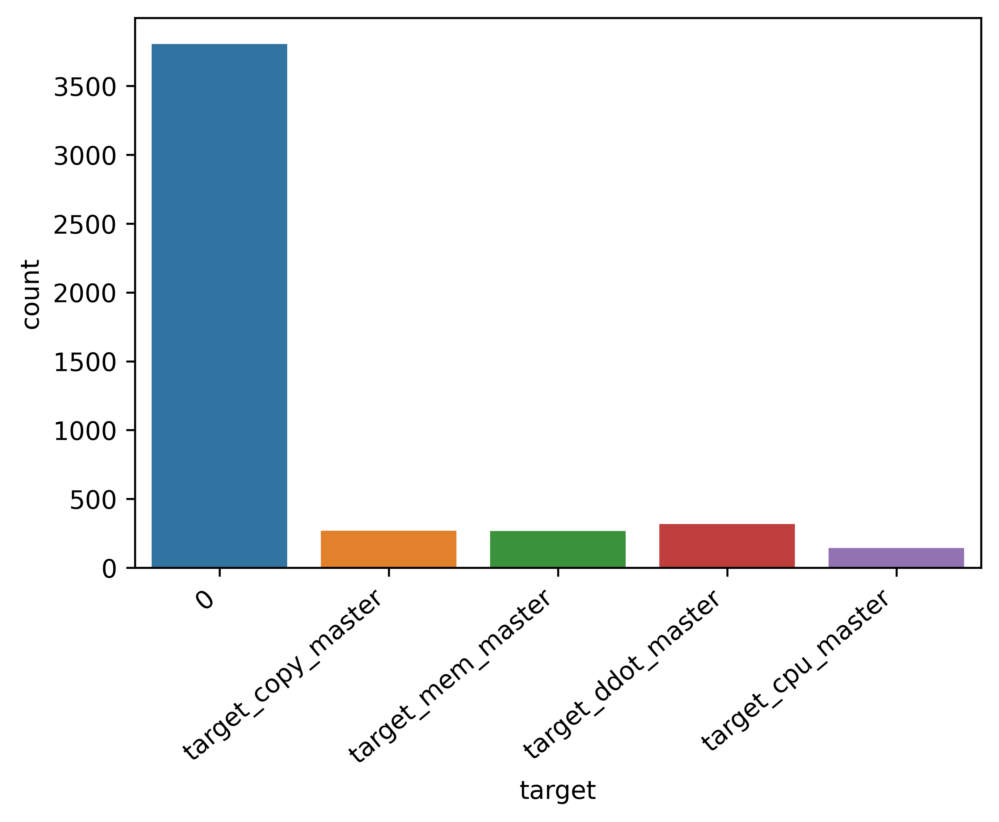

In [5]:
# Plot class distribution
print("Ploting class distribution ..")
plt.figure(dpi=600) #For publication only
class_dist_plot = sns.countplot(nice_y)
class_dist_plot.set_xticklabels(class_dist_plot.get_xticklabels(), rotation=40, ha="right")
fig_cd = class_dist_plot.get_figure()
fig_cd.savefig(os.path.join(model_dir,"class_dist_single_anomaly.png"), bbox_inches='tight')

In [6]:
print("Splitting dataset into training and ground truth ...")
X = data.drop('target', axis=1)
y = data['target']

Splitting dataset into training and ground truth ...


In [7]:
print("Scaling dataset")
# scaler = StandardScaler()
# scaler = RobustScaler()
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)
X = pd.DataFrame(X_scaled, index=X.index, columns=X.columns) #

Scaling dataset


In [8]:
# DNN best performing
from tensorflow.keras import Model
from tensorflow.keras import Input
from tensorflow.keras.layers import Dense
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv1D, Dropout, LSTM, SimpleRNN
from tensorflow.keras.optimizers import Adam, Adagrad, SGD
from tensorflow.keras.utils import plot_model
# params = {
#     "n_estimators": 10,
#     "max_depth": 25,
#     "max_features": 20,
#     "min_samples_split": 2,
#     "min_samples_leaf": 5,
#     "criterion": "gini",
#     "random_state": 42,
#     "n_jobs": -1
# }

# params = {"n_estimators": 1000,
#     "max_depth": 5,
#     "max_features": 50,
#     "min_samples_split": 2,
#     "min_samples_leaf": 11,
#     "criterion": "gini",
#     "random_state": 42,
#     "n_jobs": -1}

params = {"optimizer": "sgd",
          "learning_r": 0.01,
          "kernel_init": "he_uniform",
          "layer_1": 50,
          "layer_2": 50,
          "layer_3": 50,
          "layer_0": 100,
          "drop": 0,
          "loss": "categorical_crossentropy",
          "activation_1": "selu",
          "out_activation": "sigmoid"}



def dnn_serrano(optimizer='adam', #adam, adagrad, sgd
               learning_r = 0.01,
              kernel_init='he_uniform',
              layer_1 = 20,
              layer_2 = 40,
              layer_3 = 40,
              layer_0 = 100,
              drop = 0.1,
              loss='categorical_crossentropy',
              activation_1 = 'relu', # elu, selu
              out_activation='sigmoid'):
    # y_oh = pd.get_dummies(y, prefix='target')
    # n_inputs, n_outputs = X.shape[1], len(y_oh.nunique())
    n_inputs, n_outputs = 89, 5
    x_in = Input(shape=n_inputs)
    if layer_0:
        x=Dense(layer_0, input_dim=n_inputs, kernel_initializer=kernel_init, activation=activation_1)(x_in)
        x=Dropout(drop)(x)
    if layer_1:
        x=Dense(layer_1, input_dim=n_inputs, kernel_initializer=kernel_init, activation=activation_1)(x)
        x=Dropout(drop)(x)
    if layer_2:
        x=Dense(layer_2, input_dim=n_inputs, kernel_initializer=kernel_init, activation=activation_1)(x)
        x=Dropout(drop)(x)
    if layer_3:
        x=Dense(layer_3, input_dim=n_inputs, kernel_initializer=kernel_init, activation=activation_1)(x)
        x=Dropout(drop)(x)
    x_out = Dense(n_outputs, activation=out_activation)(x)
    if optimizer == 'adam':
        opt = Adam(learning_rate=learning_r)
    if optimizer == 'adagrad':
        opt = Adagrad(learning_rate=learning_r)
    if optimizer == 'sgd':
        opt = SGD(learning_rate=learning_r)
    else:
        opt = Adam(learning_rate=0.01)
    model = Model(inputs=x_in, outputs=x_out)
    model.compile(optimizer=opt, loss=loss, metrics=['accuracy'])
    # early_stopping = EarlyStopping(monitor="loss", patience = patience)# early stop patience
    # history = model.fit(np.asarray(X), np.asarray(y_oh),
    #                     batch_size=batch_size,
    #                     epochs=epochs,
    #                     callbacks = [early_stopping],
    #                     verbose=1) #verbose set to 1 will show the training process

    return model

# clf = KerasClassifier(build_fn=dnn_serrano, verbose=1)
clf = dnn_serrano(**params)
clf.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 89)]              0         
_________________________________________________________________
dense (Dense)                (None, 100)               9000      
_________________________________________________________________
dropout (Dropout)            (None, 100)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 50)                5050      
_________________________________________________________________
dropout_1 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 50)                2550      
_________________________________________________________________
dropout_2 (Dropout)          (None, 50)                0     

2022-05-09 15:21:02.432179: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Starting fold 1
Scaling data ....
Start training ....
Epoch 1/1000


2022-05-09 15:21:02.546150: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)


76/76 [==============================] - 1s 7ms/step - loss: 0.9380 - accuracy: 0.7675 - val_loss: 0.3441 - val_accuracy: 0.8570
Epoch 2/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.2355 - accuracy: 0.9371 - val_loss: 0.2263 - val_accuracy: 0.9453
Epoch 3/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.1693 - accuracy: 0.9610 - val_loss: 0.1323 - val_accuracy: 0.9655
Epoch 4/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.1002 - accuracy: 0.9821 - val_loss: 0.1426 - val_accuracy: 0.9512
Epoch 5/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0932 - accuracy: 0.9827 - val_loss: 0.0780 - val_accuracy: 0.9823
Epoch 6/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0626 - accuracy: 0.9907 - val_loss: 0.1364 - val_accuracy: 0.9571
Epoch 7/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0509 - accuracy: 0.9914 - val_loss: 0.0716 - val_accuracy: 0.9773
Epoch 8/1000
76/76 

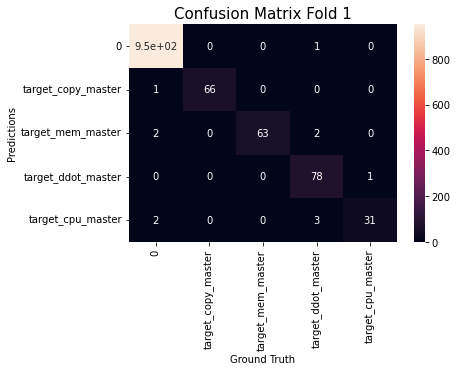

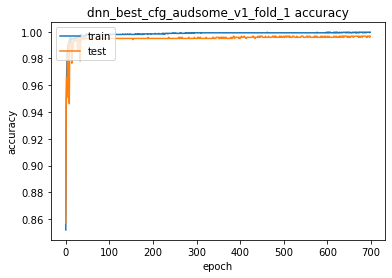

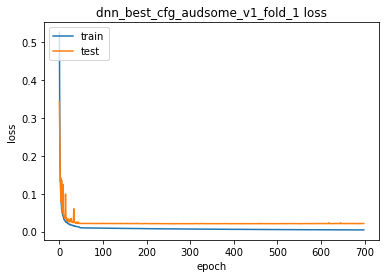

####################################################################################################
Starting fold 2
Scaling data ....
Start training ....
Epoch 1/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0133 - accuracy: 0.9979 - val_loss: 0.0413 - val_accuracy: 0.9916
Epoch 2/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0131 - accuracy: 0.9975 - val_loss: 0.0410 - val_accuracy: 0.9916
Epoch 3/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0128 - accuracy: 0.9979 - val_loss: 0.0406 - val_accuracy: 0.9916
Epoch 4/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0126 - accuracy: 0.9975 - val_loss: 0.0408 - val_accuracy: 0.9916
Epoch 5/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0123 - accuracy: 0.9971 - val_loss: 0.0401 - val_accuracy: 0.9916
Epoch 6/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9975 - val_loss: 0.0408 - val_accuracy: 

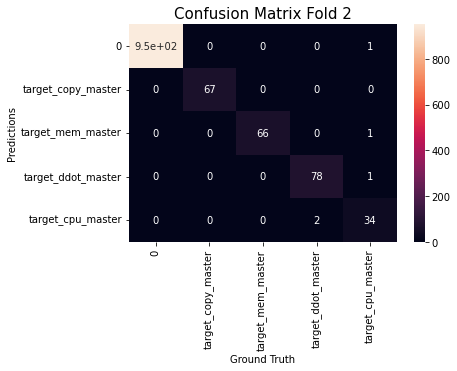

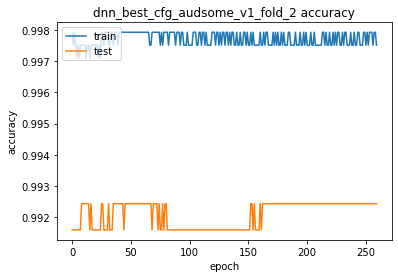

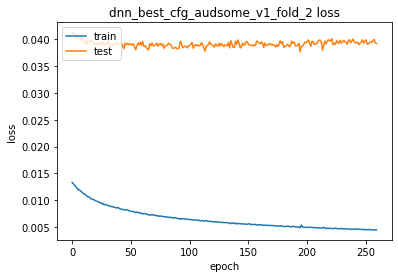

####################################################################################################
Starting fold 3
Scaling data ....
Start training ....
Epoch 1/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9950 - val_loss: 0.0104 - val_accuracy: 0.9958
Epoch 2/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0244 - accuracy: 0.9946 - val_loss: 0.0107 - val_accuracy: 0.9958
Epoch 3/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0240 - accuracy: 0.9950 - val_loss: 0.0106 - val_accuracy: 0.9958
Epoch 4/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0237 - accuracy: 0.9946 - val_loss: 0.0107 - val_accuracy: 0.9958
Epoch 5/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9946 - val_loss: 0.0108 - val_accuracy: 0.9958
Epoch 6/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0232 - accuracy: 0.9946 - val_loss: 0.0108 - val_accuracy: 

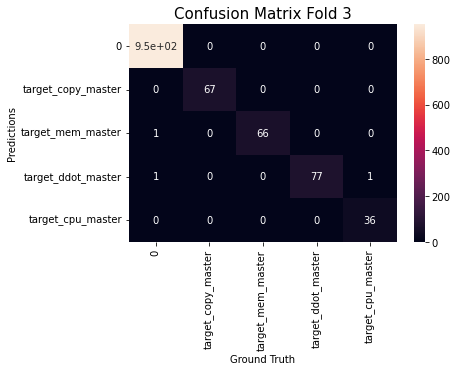

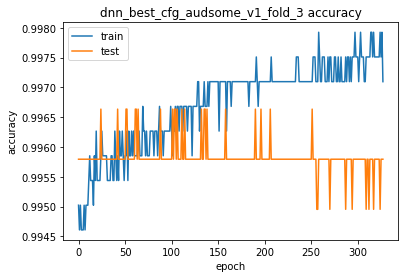

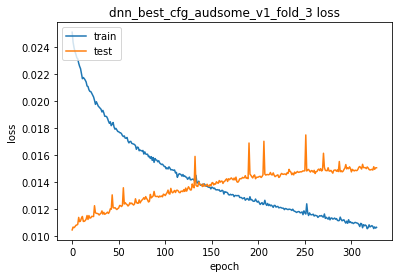

####################################################################################################
Starting fold 4
Scaling data ....
Start training ....
Epoch 1/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0100 - accuracy: 0.9979 - val_loss: 0.0190 - val_accuracy: 0.9958
Epoch 2/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0095 - accuracy: 0.9975 - val_loss: 0.0191 - val_accuracy: 0.9950
Epoch 3/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0090 - accuracy: 0.9979 - val_loss: 0.0196 - val_accuracy: 0.9958
Epoch 4/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0089 - accuracy: 0.9975 - val_loss: 0.0201 - val_accuracy: 0.9950
Epoch 5/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0090 - accuracy: 0.9975 - val_loss: 0.0196 - val_accuracy: 0.9950
Epoch 6/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0088 - accuracy: 0.9975 - val_loss: 0.0206 - val_accuracy: 

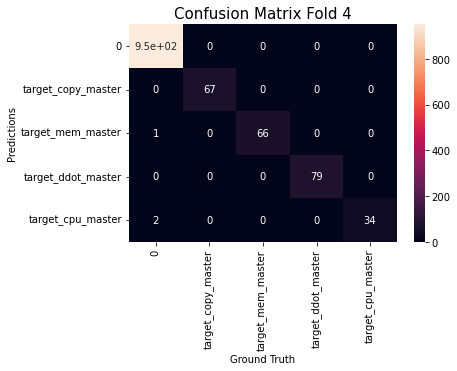

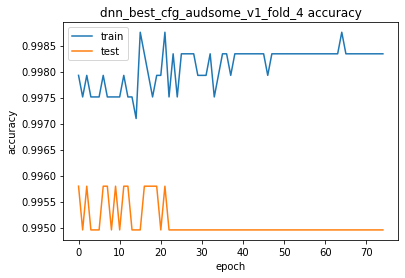

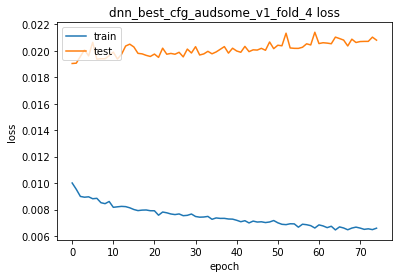

####################################################################################################
Starting fold 5
Scaling data ....
Start training ....
Epoch 1/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0135 - accuracy: 0.9963 - val_loss: 0.0115 - val_accuracy: 0.9983
Epoch 2/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0128 - accuracy: 0.9959 - val_loss: 0.0114 - val_accuracy: 0.9983
Epoch 3/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0124 - accuracy: 0.9959 - val_loss: 0.0118 - val_accuracy: 0.9975
Epoch 4/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0121 - accuracy: 0.9963 - val_loss: 0.0123 - val_accuracy: 0.9975
Epoch 5/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0121 - accuracy: 0.9963 - val_loss: 0.0125 - val_accuracy: 0.9975
Epoch 6/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0119 - accuracy: 0.9963 - val_loss: 0.0121 - val_accuracy: 

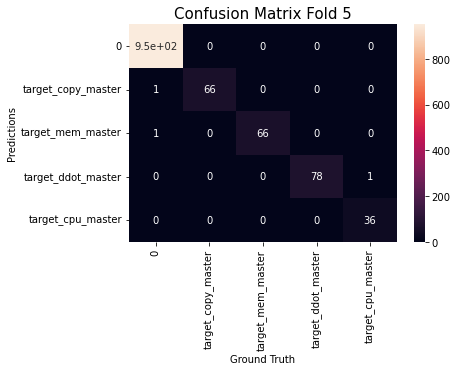

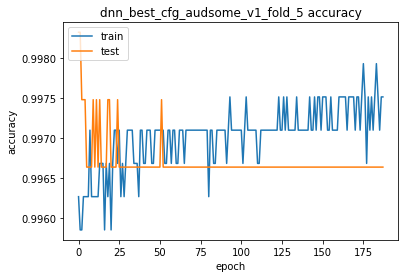

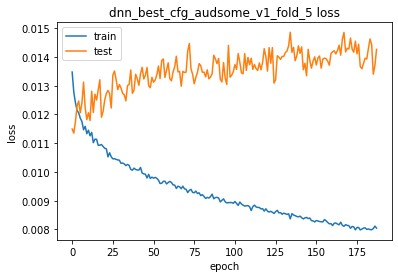

####################################################################################################


In [9]:
sss = StratifiedShuffleSplit(n_splits=5, test_size=0.25, random_state=21)
ml_method = 'dnn_best_cfg_audsome_v1'
print("="*100)
clf_models = []
report = {
    "Accuracy": [],
    "BallancedAccuracy": [],
    "Jaccard": []
}
fold = 1
for train_index, test_index in sss.split(X, y):
    # print("Train:", train_index, "Test:", test_index)
    print("Starting fold {}".format(fold))
    Xtrain, Xtest = X.iloc[train_index], X.iloc[test_index]
    ytrain, ytest = y.iloc[train_index], y.iloc[test_index]
    print("Scaling data ....")
    Xtrain = scaler.fit_transform(Xtrain)
    Xtest = scaler.transform(Xtest)
    print("Start training ....")
    patience=10
    batch_size=32
    epochs=1000
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=5, min_lr=0.001)
    early_stopping = EarlyStopping(monitor="loss", patience = patience)# early stop patience
    y_oh = pd.get_dummies(ytrain, prefix='target')
    history = clf.fit(np.asarray(Xtrain), np.asarray(y_oh),
                        batch_size=batch_size,
                        epochs=epochs,
                        callbacks = [early_stopping,
                                     reduce_lr
                                     ],
                      validation_split=0.33,
                        verbose=1)

    # Append model
    clf_models.append(clf)
    print("Predicting ....")
    ypred = clf.predict(Xtest)

    y_oh_test = pd.get_dummies(ytest, prefix='target')
    ypred = np.argmax(ypred, axis=1)


    print("-"*100)
    acc = accuracy_score(np.asarray(ytest), np.asarray(ypred))
    report['Accuracy'].append(acc)
    print("Accuracy score fold {} is: {}".format(fold, acc))
    bacc = balanced_accuracy_score(ytest, ypred)
    report['BallancedAccuracy'].append(bacc)
    print("Ballanced accuracy fold {} score is: {}".format(fold, bacc))
    jaccard = jaccard_score(ytest, ypred, average='micro')
    print("Jaccard score fold {}: {}".format(fold, jaccard))
    report['Jaccard'].append(jaccard)

    ###
    print("Full classification report for fold {}".format(fold))
    print(classification_report(ytest, ypred, digits=4,target_names=definitions))

    cf_report = classification_report(ytest, ypred, output_dict=True, digits=4, target_names=definitions)
    df_classification_report = pd.DataFrame(cf_report).transpose()
    print("Saving classification report")
    classification_rep_name = "classification_{}_fold_{}.csv".format(ml_method, fold)
    df_classification_report.to_csv(os.path.join(model_dir,classification_rep_name), index=False)


    ###
    print("Imbalanced Classification report for fold {}".format(fold))
    print(classification_report_imbalanced(ytest, ypred, digits=4, target_names=definitions))
    imb_cf_report = classification_report_imbalanced(ytest, ypred, output_dict=True, digits=4, target_names=definitions)
    df_imb_classification_report = pd.DataFrame(imb_cf_report).transpose()
    print("Saving imbalanced classification report")
    imb_classification_rep_name = "imb_classification_{}_fold_{}.csv".format(ml_method, fold)
    df_imb_classification_report.to_csv(os.path.join(model_dir,imb_classification_rep_name), index=False)
    ###
    print("Generating confusion matrix fold {}".format(fold))
    cf_matrix = confusion_matrix(ytest, ypred)

    # plt.figure(figsize=(10,20), dpi=600) For publication only
    ht_cf=sns.heatmap(cf_matrix, annot=True, yticklabels=list(definitions), xticklabels=list(definitions))
    plt.title('Confusion Matrix Fold {}'.format(fold), fontsize = 15) # title with fontsize 20
    plt.xlabel('Ground Truth', fontsize = 10) # x-axis label with fontsize 15
    plt.ylabel('Predictions', fontsize = 10) # y-axis label with fontsize 15
    cf_fig = "CM_{}_{}.png".format(ml_method, fold)
    ht_cf.figure.savefig(os.path.join(model_dir, cf_fig), bbox_inches='tight')
    plt.show()
    # DNN visualize history

    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'{ml_method}_fold_{fold} accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    h_acc_fig = "DNN_Acc_{}_{}.png".format(ml_method, fold)
    plt.savefig(os.path.join(model_dir, h_acc_fig))
    plt.show()

    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'{ml_method}_fold_{fold} loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    h_loss_fig = "DNN_Loss_{}_{}.png".format(ml_method, fold)
    plt.savefig(os.path.join(model_dir, h_loss_fig))
    plt.show()


    # DNN history export
    df_history = pd.DataFrame(history.history)
    history_name = "{}_{}_history.csv".format(ml_method, fold)
    df_history.to_csv(os.path.join(model_dir, history_name), index=False)
    #increment fold count
    fold+=1
    print("#"*100)

In [10]:
print("Saving final report ...")
# Validation Report
df_report = pd.DataFrame(report)
final_report = "Model_{}_report.csv".format(ml_method)
df_report.to_csv(os.path.join(model_dir,final_report), index=False)

Saving final report ...


Epoch 1/1000
31/31 [==============================] - 0s 4ms/step - loss: 0.9845 - accuracy: 0.7563 - val_loss: 0.9899 - val_accuracy: 0.7374
Epoch 2/1000
31/31 [==============================] - 0s 2ms/step - loss: 0.8653 - accuracy: 0.7886 - val_loss: 0.8684 - val_accuracy: 0.7668
Epoch 3/1000
31/31 [==============================] - 0s 2ms/step - loss: 0.8192 - accuracy: 0.7965 - val_loss: 0.8672 - val_accuracy: 0.8025
Epoch 4/1000
31/31 [==============================] - 0s 2ms/step - loss: 0.8110 - accuracy: 0.7965 - val_loss: 0.8494 - val_accuracy: 0.8025
Epoch 5/1000
31/31 [==============================] - 0s 2ms/step - loss: 0.8034 - accuracy: 0.7965 - val_loss: 0.8478 - val_accuracy: 0.8025
Epoch 6/1000
31/31 [==============================] - 0s 2ms/step - loss: 0.7998 - accuracy: 0.7965 - val_loss: 0.8403 - val_accuracy: 0.8046
Epoch 7/1000
31/31 [==============================] - 0s 2ms/step - loss: 0.7962 - accuracy: 0.7965 - val_loss: 0.8379 - val_accuracy: 0.8046
Epoch 

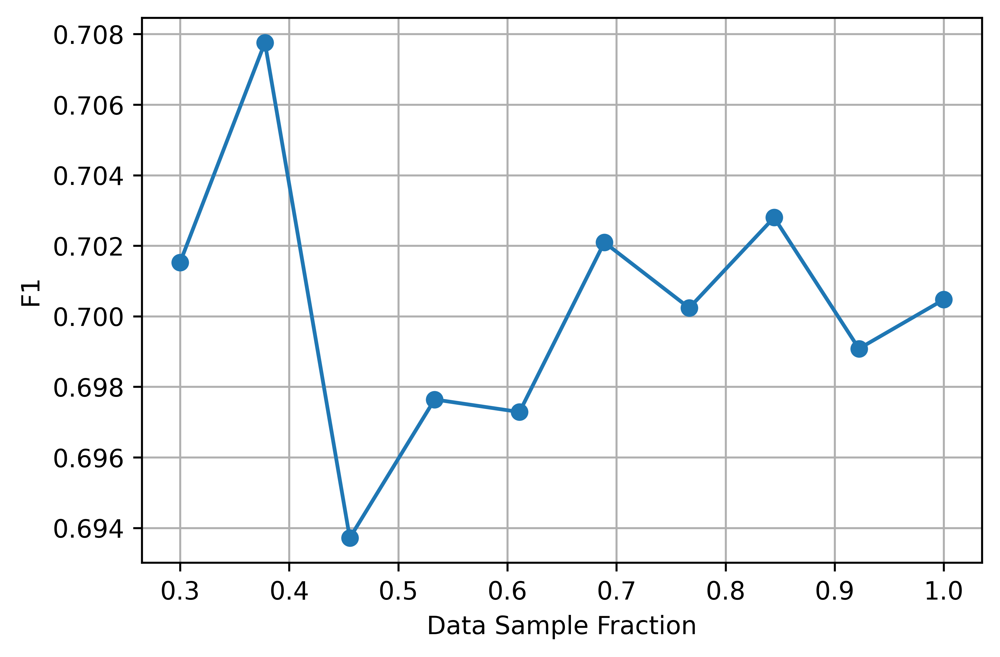

In [11]:
# Custom Learning Curve
from sklearn.metrics import f1_score
# from sklearn.learning_curve import learning_curve

plt.figure(dpi=600)
plt.grid()
dist = np.linspace(0.3, 1.0, 10)
score_sets = []
clf_lr_sample = dnn_serrano(**params)
for frac in dist:
    X_subset = X.sample(frac=frac)
    y_subset = y.sample(frac=frac)
    patience=5
    batch_size=32
    epochs=1000
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=3, min_lr=0.0001)
    early_stopping = EarlyStopping(monitor="loss", patience = patience)# early stop patience
    y_oh = pd.get_dummies(y_subset, prefix='target')
    history = clf_lr_sample.fit(np.asarray(X_subset), np.asarray(y_oh),
                        batch_size=batch_size,
                        epochs=epochs,
                        callbacks = [early_stopping,
                                     reduce_lr,
                                     ],
                      validation_split=0.33,
                                shuffle=False,
                        verbose=1)
    ypredict = clf_lr_sample.predict(X_subset)
    ypredict = np.argmax(ypredict, axis=1)
    f1_weighted_score=f1_score(y_subset, ypredict, average='weighted')
    score_sets.append(f1_weighted_score)
    # Save history
    df_history = pd.DataFrame(history.history)
    history_name = "{}_{}_history_learningcurve.csv".format(ml_method, frac)
    df_history.to_csv(os.path.join(model_dir, history_name), index=False)

# Plot learningcurve dnn
plt.plot(dist,score_sets, marker='o')
plt.ylabel('F1')
plt.xlabel('Data Sample Fraction')
plt.savefig(os.path.join(model_dir, f"{ml_method}_learningcurve.png"))
plt.show()


In [12]:
# # Type of optimizers
# plt.figure(dpi=600)
# # param_range = [
# #     "adam",
# #     "sgd",
# #     "adagrad"
# # ]
#
# param_range = [
#     {"optimizer":"adagrad"},
#     {"optimizer":"sgd"},
#     {"optimizer":"adam"},
#     ]
#
# params = {"optimizer": 'adam',
#           "learning_r": 0.01,
#           "kernel_init": "he_uniform",
#           "layer_1": 50,
#           "layer_2": 50,
#           "layer_3": 50,
#           "layer_0": 100,
#           "drop": 0,
#           "loss": "categorical_crossentropy",
#           "activation_1": "selu",
#           "out_activation": "sigmoid"}
#
# score_sets = []
#
# for param in param_range:
#
#     params.update(param)
#     print(f"Params are set to: {params}")
#     clf_opt = dnn_serrano(**params)
#     patience=10
#     batch_size=32
#     epochs=1000
#     reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
#                               patience=5, min_lr=0.001)
#     early_stopping = EarlyStopping(monitor="loss", patience = patience)# early stop patience
#     y_oh = pd.get_dummies(y, prefix='target')
#     history = clf_opt.fit(np.asarray(X), np.asarray(y_oh),
#                         batch_size=batch_size,
#                         epochs=epochs,
#                         callbacks = [early_stopping,
#                                      reduce_lr,
#                                      ],
#                       validation_split=0.33,
#                                 shuffle=False,
#                         verbose=1)
#     ypredict = clf_opt.predict(X)
#     ypredict = np.argmax(ypredict, axis=1)
#     f1_weighted_score=f1_score(y, ypredict, average='weighted')
#     score_sets.append(f1_weighted_score)
#     # Save history
#     df_history = pd.DataFrame(history.history)
#     history_name = "{}_{}_history_{}_learningcurve.csv".format(ml_method, param, "optimizer")
#     df_history.to_csv(os.path.join(model_dir, history_name), index=False)
#
# lparam_range = []
# for e in param_range:
#     lparam_range.append(list(e.values())[0])
# # Plot learningcurve dnn
# plt.plot(lparam_range,score_sets, marker='o')
# plt.ylabel('F1')
# plt.xlabel('Optimizers')
# plt.savefig(os.path.join(model_dir, f"{ml_method}_optimizer_learningcurve.png"))
# plt.show()

Params are set to: {'optimizer': 'adagrad', 'learning_r': 0.01, 'kernel_init': 'he_uniform', 'layer_1': 50, 'layer_2': 50, 'layer_3': 50, 'layer_0': 100, 'drop': 0, 'loss': 'categorical_crossentropy', 'activation_1': 'selu', 'out_activation': 'sigmoid'}
Epoch 1/1000
76/76 [==============================] - 1s 2ms/step - loss: 1.6056 - accuracy: 0.7254 - val_loss: 0.2235 - val_accuracy: 0.9394
Epoch 2/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.1297 - accuracy: 0.9659 - val_loss: 0.1839 - val_accuracy: 0.9537
Epoch 3/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.1265 - accuracy: 0.9686 - val_loss: 0.0623 - val_accuracy: 0.9823
Epoch 4/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0563 - accuracy: 0.9881 - val_loss: 0.0524 - val_accuracy: 0.9882
Epoch 5/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.0508 - accuracy: 0.9887 - val_loss: 0.0866 - val_accuracy: 0.9882
Epoch 6/1000
76/76 [================

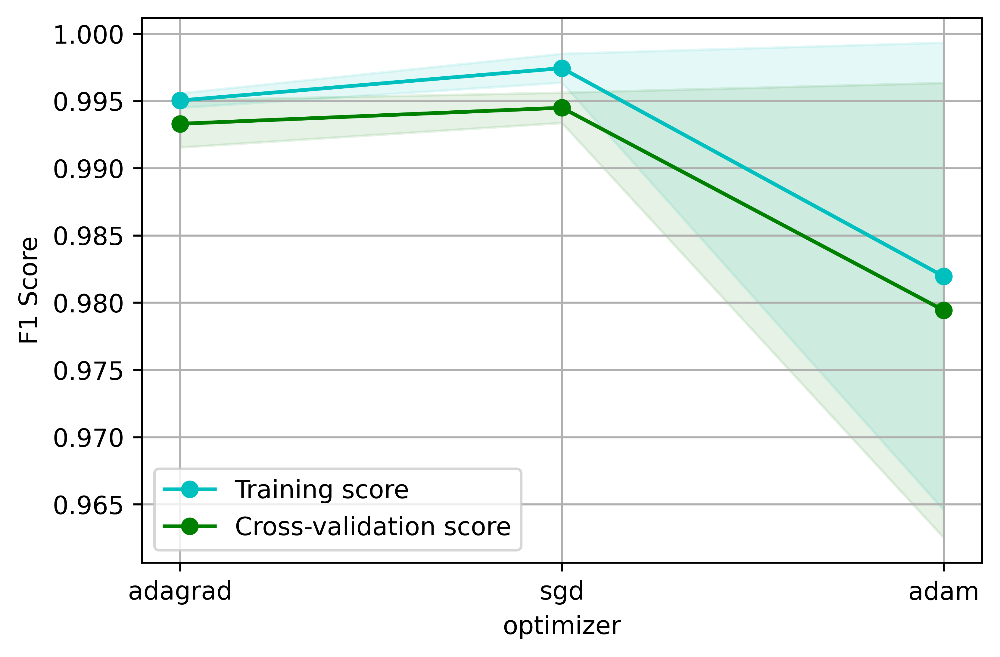

In [13]:
# Type of optimizers
plt.figure(dpi=600)
# param_range = [
#     "adam",
#     "sgd",
#     "adagrad"
# ]

param_range = [
    {"optimizer":"adagrad"},
    {"optimizer":"sgd"},
    {"optimizer":"adam"},
    ]

params = {"optimizer": 'adam',
          "learning_r": 0.01,
          "kernel_init": "he_uniform",
          "layer_1": 50,
          "layer_2": 50,
          "layer_3": 50,
          "layer_0": 100,
          "drop": 0,
          "loss": "categorical_crossentropy",
          "activation_1": "selu",
          "out_activation": "sigmoid"}

score_sets = []

np_train_scores = np.empty((0, sss.n_splits))
np_test_scores = np.empty((0, sss.n_splits))

# Get param name and values
param_values = []
param_name = list(param_range[0].keys())[0]
for d in param_range:
    param_values.append(list(d.values())[0])
param_labels = param_values

# Check if param values have string type
if any(isinstance(item, str) for item in param_values):
    len_param_values = len(param_values)
    param_values = list(range(0,len_param_values))


for param in param_range:
    params.update(param)
    print(f"Params are set to: {params}")
    cv_scores_train = []
    cv_scores_test = []
    y_oh = pd.get_dummies(y, prefix='target')
    fold=1
    for train_index, test_index in sss.split(X, y_oh):
        Xtrain, Xtest = X.iloc[train_index], X.iloc[test_index]
        ytrain, ytest = y_oh.iloc[train_index], y_oh.iloc[test_index]
        clf_opt = dnn_serrano(**params)
        patience=10
        batch_size=32
        epochs=1000
        reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                                  patience=5, min_lr=0.001)
        early_stopping = EarlyStopping(monitor="loss", patience = patience)# early stop patience

        history = clf_opt.fit(np.asarray(Xtrain), np.asarray(ytrain),
                            batch_size=batch_size,
                            epochs=epochs,
                            callbacks = [early_stopping,
                                         reduce_lr,
                                         ],
                          validation_split=0.33,
                                    shuffle=False,
                            verbose=1)
        ypredict = clf_opt.predict(Xtrain)
        ypredict = np.argmax(ypredict, axis=1)
        ytrain_d = np.argmax(np.asarray(ytrain), axis=1)
        f1_weighted_score_train=f1_score(ytrain_d, ypredict, average='weighted')

        ypredict_test = clf_opt.predict(Xtest)
        ypredict_test = np.argmax(ypredict_test, axis=1)
        ytest_d = np.argmax(np.asarray(ytest), axis=1)
        f1_weighted_score_test=f1_score(ytest_d, ypredict_test, average='weighted')
        cv_scores_test.append(f1_weighted_score_test)
        cv_scores_train.append(f1_weighted_score_train)

        # Save history
        df_history = pd.DataFrame(history.history)
        history_name = "{}_{}_history_Fold{}_{}_learningcurve.csv".format(ml_method, param, fold, "optimizer")
        df_history.to_csv(os.path.join(model_dir, history_name), index=False)
        fold+=1

    np_train_scores = np.append(np_train_scores,[cv_scores_train], axis=0)
    np_test_scores = np.append(np_test_scores,[cv_scores_test], axis=0)

# Compute for fill_between plot
np_train_scores_mean = np.mean(np_train_scores, axis=1)
np_train_scores_std = np.std(np_train_scores, axis=1)
np_test_scores_mean = np.mean(np_test_scores, axis=1)
np_test_scores_std = np.std(np_test_scores, axis=1)

# Plot
plt.grid()
plt.fill_between(param_values, np_train_scores_mean - np_train_scores_std,
             np_train_scores_mean + np_train_scores_std, alpha=0.1,
             color="c")
plt.fill_between(param_values, np_test_scores_mean - np_test_scores_std,
             np_test_scores_mean + np_test_scores_std, alpha=0.1, color="g")
plt.plot(param_values, np_train_scores_mean, 'o-', color="c",
     label="Training score")
plt.plot(param_values, np_test_scores_mean, 'o-', color="g",
     label="Cross-validation score")

# Labels and legends
plt.xticks(ticks=param_values, labels=param_labels)
plt.ylabel("F1 Score")
plt.xlabel(param_name)
# plt.legend(loc='upper right')
plt.legend(loc="best")
plt.savefig(os.path.join(model_dir, f"{ml_method}_optimizer_learningcurve.png"))
plt.show()

Starting params: {'optimizer': 'sgd', 'learning_r': 0.01, 'kernel_init': 'he_uniform', 'layer_1': 0, 'layer_2': 50, 'layer_3': 50, 'layer_0': 100, 'drop': 0, 'loss': 'categorical_crossentropy', 'activation_1': 'selu', 'out_activation': 'sigmoid'}
Epoch 1/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.8603 - accuracy: 0.7423 - val_loss: 0.3861 - val_accuracy: 0.8478
Epoch 2/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.3121 - accuracy: 0.9030 - val_loss: 0.2515 - val_accuracy: 0.9277
Epoch 3/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.2018 - accuracy: 0.9552 - val_loss: 0.1832 - val_accuracy: 0.9420
Epoch 4/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.1476 - accuracy: 0.9692 - val_loss: 0.1430 - val_accuracy: 0.9546
Epoch 5/1000
76/76 [==============================] - 0s 1ms/step - loss: 0.1165 - accuracy: 0.9783 - val_loss: 0.1176 - val_accuracy: 0.9622
Epoch 6/1000
76/76 [=======================

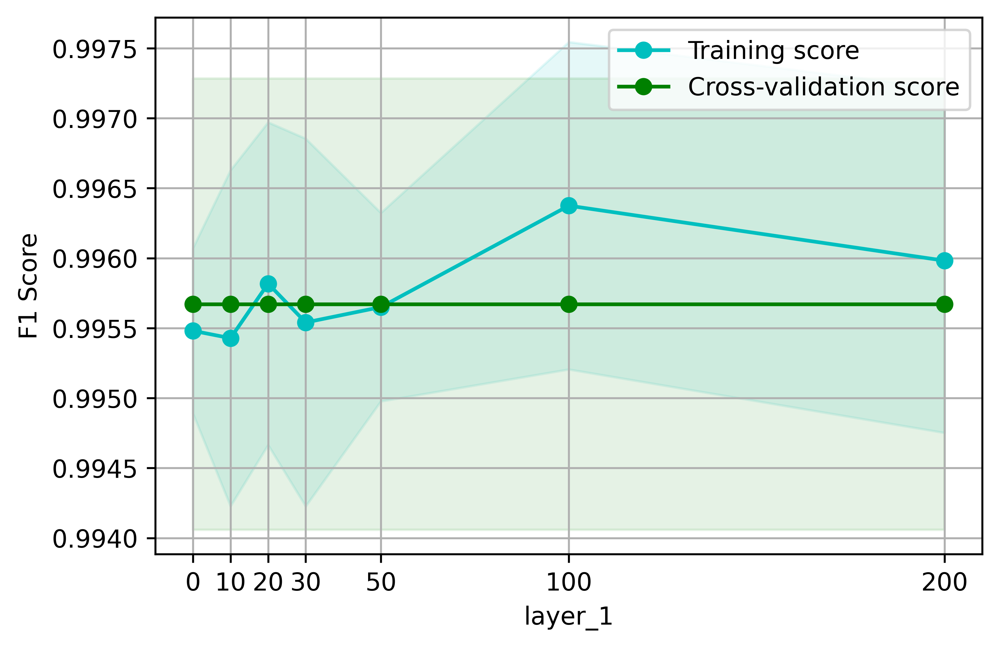

In [14]:
# Layer 1 size
param_range = [
    {"layer_1":0},
    {"layer_1":10},
    {"layer_1":20},
    {"layer_1":30},
    {"layer_1":50},
    {"layer_1":100},
    {"layer_1":200}
    ]


params = {"optimizer": "sgd",
              "learning_r": 0.01,
              "kernel_init": "he_uniform",
              "layer_1": 50,
              "layer_2": 50,
              "layer_3": 50,
              "layer_0": 100,
              "drop": 0,
              "loss": "categorical_crossentropy",
              "activation_1": "selu",
              "out_activation": "sigmoid"}

def param_learning_curve(X,
                         y,
                         params,
                         param_range,
                         ml_method,
                         label,
                         cv,
                         patience=10,
                         batch_size=32,
                         epochs=1000):
    """
    :param X: Dataset for training
    :param y: Ground Truth of training data
    :param params: dictionary of DNN params
    :param param_range: parameter range for dict
    :param ml_method: ml_method unique identifier
    :param label: label for X axis of visualziation
    :param patience: patience for early stopping
    :param batch_size: batch size for training
    :param epochs: Number of epoch for training
    :return:
    """
    plt.figure(dpi=600)
    score_sets_p = []

    np_train_scores = np.empty((0, sss.n_splits))
    np_test_scores = np.empty((0, sss.n_splits))

    # Get param name and values
    param_values = []
    param_name = list(param_range[0].keys())[0]
    for d in param_range:
        param_values.append(list(d.values())[0])
    param_labels = param_values

    # Check if param values have string type
    if any(isinstance(item, str) for item in param_values):
        len_param_values = len(param_values)
        param_values = list(range(0,len_param_values))


    for param in param_range:
        params.update(param)
        print(f"Starting params: {params}")
        cv_scores_train = []
        cv_scores_test = []

        y_oh = pd.get_dummies(y, prefix='target')
        fold=1
        for train_index, test_index in cv.split(X, y_oh):
            Xtrain, Xtest = X.iloc[train_index], X.iloc[test_index]
            ytrain, ytest = y_oh.iloc[train_index], y_oh.iloc[test_index]
            clf_param = dnn_serrano(**params)

            reduce_lr_p = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                                      patience=2, min_lr=0.001)
            early_stopping_p = EarlyStopping(monitor="val_loss", patience = patience)# early stop patience
            history_p = clf_param.fit(np.asarray(Xtrain), np.asarray(ytrain),
                                batch_size=batch_size,
                                epochs=epochs,
                                callbacks = [early_stopping_p,
                                             reduce_lr_p,
                                             ],
                              validation_split=0.33,
                                        shuffle=False,
                                verbose=1)

            ypred_p = clf_param.predict(Xtrain)
            ypred_p = np.argmax(ypred_p, axis=1)
            ytrain_d = np.argmax(np.asarray(ytrain), axis=1)
            f1_weighted_score_train=f1_score(ytrain_d, ypred_p, average='weighted')

            ypredict_test = clf_opt.predict(Xtest)
            ypredict_test = np.argmax(ypredict_test, axis=1)
            ytest_d = np.argmax(np.asarray(ytest), axis=1)
            f1_weighted_score_test=f1_score(ytest_d, ypredict_test, average='weighted')

            cv_scores_test.append(f1_weighted_score_test)
            cv_scores_train.append(f1_weighted_score_train)

            # Save history
            dfhistory = pd.DataFrame(history_p.history)
            historyname = "{}_{}_history_{}_Fold{}_learningcurve.csv".format(ml_method, param, label, fold)
            dfhistory.to_csv(os.path.join(model_dir, historyname), index=False)
            fold+=1
        np_train_scores = np.append(np_train_scores,[cv_scores_train], axis=0)
        np_test_scores = np.append(np_test_scores,[cv_scores_test], axis=0)

    # Compute for fill_between plot
    np_train_scores_mean = np.mean(np_train_scores, axis=1)
    np_train_scores_std = np.std(np_train_scores, axis=1)
    np_test_scores_mean = np.mean(np_test_scores, axis=1)
    np_test_scores_std = np.std(np_test_scores, axis=1)


   # Plot
    plt.grid()
    plt.fill_between(param_values, np_train_scores_mean - np_train_scores_std,
                 np_train_scores_mean + np_train_scores_std, alpha=0.1,
                 color="c")
    plt.fill_between(param_values, np_test_scores_mean - np_test_scores_std,
                 np_test_scores_mean + np_test_scores_std, alpha=0.1, color="g")
    plt.plot(param_values, np_train_scores_mean, 'o-', color="c",
         label="Training score")
    plt.plot(param_values, np_test_scores_mean, 'o-', color="g",
         label="Cross-validation score")

    # Labels and legends
    plt.xticks(ticks=param_values, labels=param_labels)
    plt.ylabel("F1 Score")
    plt.xlabel(param_name)
    # plt.legend(loc='upper right')
    plt.legend(loc="best")
    plt.savefig(os.path.join(model_dir, f"{ml_method}_{label}_learningcurve.png"))
    plt.show()

param_learning_curve(X, y, params, param_range, ml_method, label="Layer_1", cv=sss)

Starting params: {'optimizer': 'sgd', 'learning_r': 0.01, 'kernel_init': 'he_uniform', 'layer_1': 200, 'layer_2': 0, 'layer_3': 50, 'layer_0': 100, 'drop': 0, 'loss': 'categorical_crossentropy', 'activation_1': 'selu', 'out_activation': 'sigmoid'}
Epoch 1/1000
76/76 [==============================] - 0s 3ms/step - loss: 0.8248 - accuracy: 0.7702 - val_loss: 0.3409 - val_accuracy: 0.8932
Epoch 2/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.2749 - accuracy: 0.9210 - val_loss: 0.2176 - val_accuracy: 0.9369
Epoch 3/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.1773 - accuracy: 0.9606 - val_loss: 0.1623 - val_accuracy: 0.9605
Epoch 4/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.1306 - accuracy: 0.9754 - val_loss: 0.1301 - val_accuracy: 0.9672
Epoch 5/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.1036 - accuracy: 0.9846 - val_loss: 0.1087 - val_accuracy: 0.9672
Epoch 6/1000
76/76 [======================

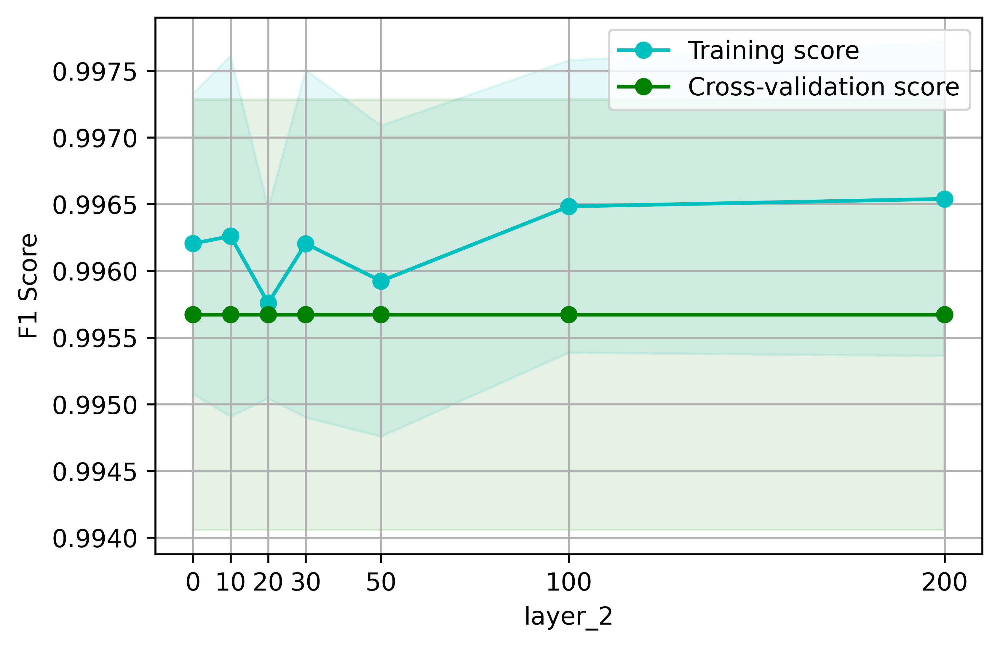

In [15]:
# Layer 2
param_range = [
    {"layer_2":0},
    {"layer_2":10},
    {"layer_2":20},
    {"layer_2":30},
    {"layer_2":50},
    {"layer_2":100},
    {"layer_2":200}
    ]
param_learning_curve(X, y, params, param_range, ml_method, label="Layer_2", cv=sss)

Starting params: {'optimizer': 'sgd', 'learning_r': 0.01, 'kernel_init': 'he_uniform', 'layer_1': 200, 'layer_2': 200, 'layer_3': 0, 'layer_0': 100, 'drop': 0, 'loss': 'categorical_crossentropy', 'activation_1': 'selu', 'out_activation': 'sigmoid'}
Epoch 1/1000
76/76 [==============================] - 0s 3ms/step - loss: 0.7506 - accuracy: 0.7731 - val_loss: 0.3170 - val_accuracy: 0.8890
Epoch 2/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.2270 - accuracy: 0.9371 - val_loss: 0.2017 - val_accuracy: 0.9361
Epoch 3/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.1490 - accuracy: 0.9696 - val_loss: 0.1464 - val_accuracy: 0.9605
Epoch 4/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.1105 - accuracy: 0.9839 - val_loss: 0.1171 - val_accuracy: 0.9647
Epoch 5/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.0889 - accuracy: 0.9863 - val_loss: 0.0999 - val_accuracy: 0.9680
Epoch 6/1000
76/76 [=====================

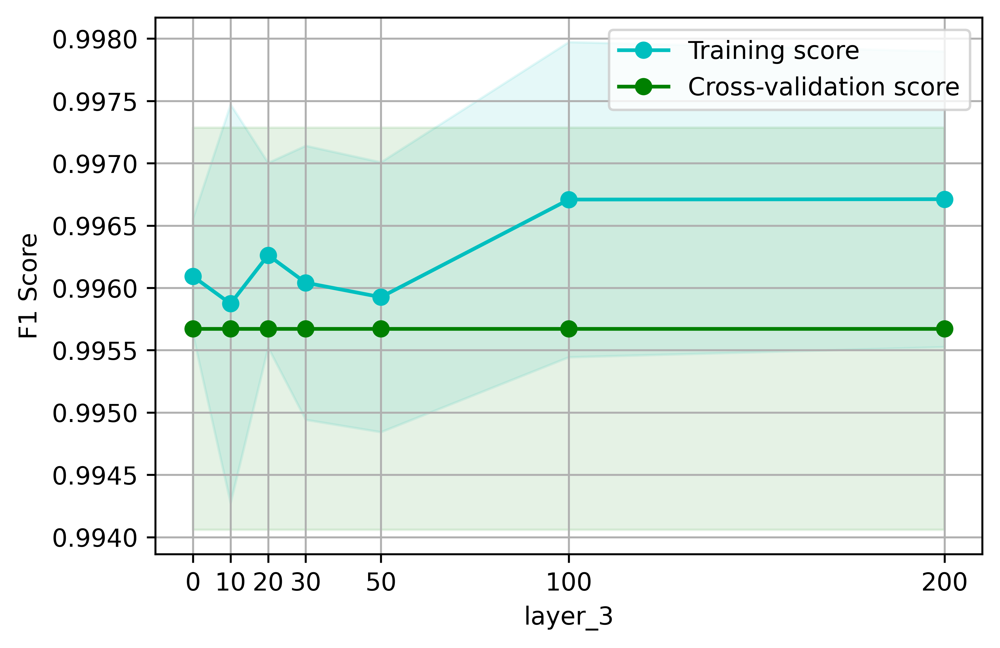

In [16]:
# Layer 3
param_range = [
    {"layer_3":0},
    {"layer_3":10},
    {"layer_3":20},
    {"layer_3":30},
    {"layer_3":50},
    {"layer_3":100},
    {"layer_3":200}
    ]

param_learning_curve(X, y, params, param_range, ml_method, label="Layer_3", cv=sss)

In [ ]:
# Layer 0
param_range = [
    {"layer_0":10},
    {"layer_0":20},
    {"layer_0":30},
    {"layer_0":50},
    {"layer_0":100},
    {"layer_0":200}
    ]

param_learning_curve(X, y, params, param_range, ml_method, label="Layer_0", cv=sss)

Starting params: {'optimizer': 'sgd', 'learning_r': 0.01, 'kernel_init': 'he_uniform', 'layer_1': 200, 'layer_2': 200, 'layer_3': 200, 'layer_0': 10, 'drop': 0, 'loss': 'categorical_crossentropy', 'activation_1': 'selu', 'out_activation': 'sigmoid'}
Epoch 1/1000
76/76 [==============================] - 0s 3ms/step - loss: 0.6763 - accuracy: 0.8077 - val_loss: 0.1384 - val_accuracy: 0.9596
Epoch 2/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.0933 - accuracy: 0.9862 - val_loss: 0.0923 - val_accuracy: 0.9689
Epoch 3/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.0629 - accuracy: 0.9912 - val_loss: 0.0861 - val_accuracy: 0.9714
Epoch 4/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.0524 - accuracy: 0.9902 - val_loss: 0.0834 - val_accuracy: 0.9781
Epoch 5/1000
76/76 [==============================] - 0s 2ms/step - loss: 0.0471 - accuracy: 0.9919 - val_loss: 0.0812 - val_accuracy: 0.9823
Epoch 6/1000
76/76 [====================

In [ ]:
# Dropout
param_range = [
    {"drop":0.0},
    {"drop":0.1},
    {"drop":0.2},
    {"drop":0.3},
    {"drop":0.5},
    {"drop":0.7},
    {"drop":0.8}
    ]
param_learning_curve(X, y, params, param_range, ml_method, label="Dropout", cv=sss)

In [ ]:
# Activation function

param_range = [
    {"activation_1":"relu"},
    {"activation_1": "elu"},
    {"activation_1": "selu"}
    ]
param_learning_curve(X, y, params, param_range, ml_method, label="Activation_1", cv=sss)

In [ ]:
# Shap for feature importance
import shap
shap.initjs()

In [ ]:
# New model for shap
patience=10
batch_size=32
epochs=1000

params_shap = {"optimizer": "sgd",
              "learning_r": 0.01,
              "kernel_init": "he_uniform",
              "layer_1": 50,
              "layer_2": 50,
              "layer_3": 50,
              "layer_0": 100,
              "drop": 0,
              "loss": "categorical_crossentropy",
              "activation_1": "selu",
              "out_activation": "sigmoid"}

clf_shap = dnn_serrano(**params_shap)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=5, min_lr=0.001)
early_stopping = EarlyStopping(monitor="loss", patience = patience)# early stop patience
y_oh = pd.get_dummies(y, prefix='target')
history = clf_shap.fit(np.asarray(X), np.asarray(y_oh),
                    batch_size=batch_size,
                    epochs=epochs,
                    callbacks = [early_stopping,
                                 reduce_lr,
                                 ],
                  validation_split=0.33,
                            shuffle=False,
                    verbose=1)
ypredict = clf_shap.predict(X)
ypredict = np.argmax(ypredict, axis=1)


In [38]:
# Compute Shap Values for a sibsample
e = shap.KernelExplainer(clf_shap, X.iloc[:50,:])
shap_values = e.shap_values(X, nsamples=100)

  0%|          | 0/5400 [00:00<?, ?it/s]

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

In [56]:
# Serialize explainer and shape values
# import cloudpickle
# with open(os.path.join(model_dir, 'explainer.pkl'), mode='wb') as file:
#    cloudpickle.dump(e, file)
#
# with open(os.path.join(model_dir, 'shap_values.pkl'), mode='wb') as file:
#    cloudpickle.dump(shap_values, file)

# get barplot
len(shap_values)


5

In [53]:
from yellowbrick.model_selection import LearningCurve, ValidationCurve, RFECV

plt.figure(dpi=600) #For publication only
#had to remove max feature 50 to high
# params_2 =  {
#     'n_estimators': 10,
#     'max_depth': 50,
#     'min_samples_split': 5,
#     'min_samples_leaf': 11,
#     'criterion': 'entropy',
#     'random_state': 42,
#     'n_jobs': -1}

params_rfecv = {
    "n_estimators": 10,
    "max_depth": 25,
    "min_samples_split": 2,
    "min_samples_leaf": 5,
    "criterion": "gini",
    "random_state": 42,
    "n_jobs": -1
}

clf_2 = RandomForestClassifier(**params_rfecv)
viz_rdecv = RFECV(clf_2, cv=sss, scoring="f1_weighted")

viz_rdecv.fit(X, y)
viz_rdecv.show(outpath=os.path.join(model_dir, f"{ml_method}_recursivefeatureelimination.png"))

ImportError: cannot import name 'safe_indexing' from 'sklearn.utils' (/Users/Gabriel/anaconda3/envs/p3envmlv3/lib/python3.8/site-packages/sklearn/utils/__init__.py)

In [ ]:
# Save features to drop and features to keep
df_features_rfe = pd.DataFrame({
    "Features": X.columns,
    "Include": viz_rdecv.support_
})

# Features to be included after rfe
df_features_rfe_include = df_features_rfe.loc[df_features_rfe['Include'] == True]
df_features_rfe_drop = df_features_rfe.loc[df_features_rfe['Include'] == False]

df_features_rfe_include.to_csv(os.path.join(model_dir, f"{ml_method}_rfe_include.csv"), index=False)
df_features_rfe_drop.to_csv(os.path.join(model_dir, f"{ml_method}_rfe_drop.csv"), index=False)

In [ ]:
from yellowbrick.classifier import PrecisionRecallCurve, ROCAUC
# plt.figure(figsize=(10,20), dpi=600) For publication only
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=True)

viz = PrecisionRecallCurve(clf, per_class=True, cmap="Set1", classes=definitions)
viz.fit(X_train, y_train)
viz.score(X_test, y_test)
viz.show(outpath=os.path.join(model_dir, f"{ml_method}_precisionrecallcurve.png"))

In [ ]:
viz = PrecisionRecallCurve(
    clf,
    classes=definitions,
    colors=["purple", "cyan", "blue", "red", "green"],
    iso_f1_curves=True,
    per_class=True,
    micro=False
)
# plt.figure(figsize=(10,20), dpi=600) For publication only
viz.fit(X_train, y_train)
viz.score(X_test, y_test)
viz.show(outpath=os.path.join(model_dir, f"{ml_method}_learningcurve_pretty.png"))

In [ ]:
from yellowbrick.classifier import PrecisionRecallCurve, ROCAUC

# plt.figure(figsize=(10,20), dpi=600) For publication only
viz = ROCAUC(clf, classes=definitions)
viz.fit(X_train, y_train)
viz.score(X_test, y_test)
viz.show(outpath=os.path.join(model_dir, f"{ml_method}_ROCAUC.png"))

Scoring on holdout or other dataset

In [ ]:
def compare_to_holdout(df_data,
                       model,
                       definitions,
                       scaler=None,
                       clean=False,
                       prefix='rf_holdout'):
    #Creating the dependent variable class
    factor_h = pd.factorize(df_data['target'])
    df_data.target = factor_h[0]
    definitions_test_data = factor_h[1]
    print("Splitting dataset into data and ground truth ...")
    X_h = df_data.drop('target', axis=1)
    y_h = df_data['target']
    # Scale same as original dataset
    if scaler is None:
        scaler = MinMaxScaler()
    X_h = scaler.fit_transform(X_h)  # scaler only used on a per fold basis may cause error on entire dataset.
    # Select model from split to be tested
    y_pred_h = model.predict(X_h)


    # Recompute custom definitions in case of mismath
    if len(list(np.unique(y_pred_h))) != len(definitions) and clean:
        print(f"Prediction contains the following classes: {list(np.unique(y_pred_h))}")
        target_names = []
        for t in list(np.unique(y_pred_h)):
            target_names.append(definitions[t])
        print(f"Mapped to: {target_names}")
    else:
        target_names = definitions
    # print(classification_report(y_h, y_pred_h, target_names=target_names))
    # print(classification_report(y_h, y_pred_h, target_names=target_names))
    # print(classification_report_imbalanced(y_h, y_pred_h), target_names=list(np.unique(y_pred_h)))
    custom_scoring_reporting(y_pred_h, y_h, definitions=target_names, prefix=prefix)

    print(f"Instances predicted by class:")
    print(f"{df_data}")
    if clean:
        cls, count =  np.unique(y_pred_h, return_counts=True)
    else:
        count = np.bincount(y_pred_h)
    print(pd.DataFrame({"Classes": target_names, "Predictions": count}))


    print("Generating confusion matrix for holdout")
    cf_matrix = confusion_matrix(y_h, y_pred_h)
    # plt.figure(figsize=(10,20), dpi=600) For publication only
    ht_cf=sns.heatmap(cf_matrix, annot=True, yticklabels=list(target_names), xticklabels=list(target_names))
    plt.title('Confusion Matrix Holdout set', fontsize = 15) # title with fontsize 20
    plt.xlabel('Ground Truth', fontsize = 10) # x-axis label with fontsize 15
    plt.ylabel('Predictions', fontsize = 10) # y-axis label with fontsize 15
    cf_fig = "CM_{}_{}.png".format(ml_method, prefix)
    ht_cf.figure.savefig(os.path.join(model_dir, cf_fig), bbox_inches='tight')
    plt.show()
    return y_pred_h, y_h.values, target_names

In [ ]:

prefix_name = "rf_holdout"

y_pred_h, y_h , target_names = compare_to_holdout(df_clean,  clf_models[0], definitions=definitions, clean=True, prefix=prefix_name)